# Arms Motion Sequence Plotter

Running this notebook will required a installation of the [vnl-playground](https://github.com/talmolab/vnl-playground) repository. You can install it via 

```bash
pip install git+https://github.com/talmolab/vnl-playground.git
```
This notebook is used to plot some of the simple behavioral sequences in several task. Specifically, we will use this notebook to plot out the trajectory sequence from the motion capture, and plot out from the track-mjx output to illustrate the performance of the task.

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


""

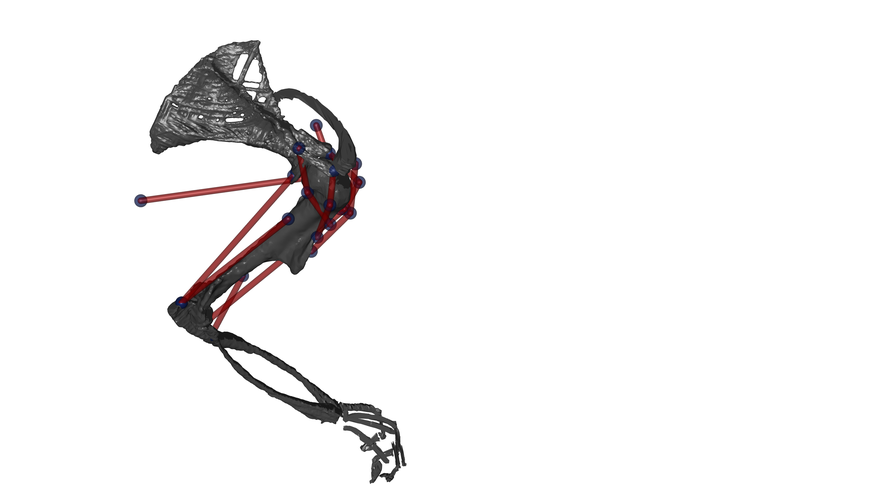

In [24]:
%load_ext autoreload
%autoreload 2

# Set up environment variables before importing any graphics-related modules
import os
import sys

# Add the parent directory to the system path to import local modules
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))

# Configure XLA and JAX settings
xla_flags = os.environ.get("XLA_FLAGS", "")
xla_flags += " --xla_gpu_triton_gemm_any=True"
os.environ["XLA_FLAGS"] = xla_flags
os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"

# Configure rendering backend - use osmesa for headless rendering
os.environ["MUJOCO_GL"] = "egl"
# Remove PYOPENGL_PLATFORM to let PyOpenGL auto-detect
if "PYOPENGL_PLATFORM" in os.environ:
    del os.environ["PYOPENGL_PLATFORM"]

# Now import the graphics-related modules
import vnl_mjx.tasks.mouse.visualize as visualize_env
import mujoco as mj
import mujoco
import mediapy as media
import imageio
import jax
from jax import numpy as jp
import numpy as np

# Enable persistent compilation cache.
jax.config.update("jax_compilation_cache_dir", "/tmp/jax_cache")
jax.config.update("jax_persistent_cache_min_entry_size_bytes", -1)
jax.config.update("jax_persistent_cache_min_compile_time_secs", 0)

def render(model, data=None, height: int = 500, camera: int | str = -1, filename="render.pdf", save=False):
    if data is None:
        data = mj.MjData(model)
    # visual mujoco rendering
    scene_option = mujoco.MjvOption()
    # scene_option.sitegroup[:] = [1, 1, 1, 1, 1, 0]
    # scene_option.flags[mujoco.mjtVisFlag.mjVIS_CONTACTPOINT] = True
    # scene_option.flags[mujoco.mjtVisFlag.mjVIS_CONTACTFORCE] = True
    scene_option.flags[mujoco.mjtRndFlag.mjRND_SHADOW] = False
    with mj.Renderer(model, 2160, 3840) as renderer:
        mj.mj_forward(model, data)
        renderer.update_scene(data, camera=camera, scene_option=scene_option)
        frame = renderer.render()
        media.show_image(frame, height=height)
        if save:
            imageio.imwrite(filename, frame)

# create three render environments for the mouses, ghost mouses, and both
env_all = visualize_env.MouseRender()
env_all.add_mouse(True, pos=(0, 0, 0), suffix="-mouse-0")
env_all.compile()

render(env_all.mj_model, camera="close-profile-mouse-0", height=500)

### environment creation

add your agents here, manipulate their names, positions.

In [51]:
# create three render environments for the rodents, ghost rodents, and both
env_imitator = visualize_env.MouseRender()
env_reference = visualize_env.MouseRender()
env_all = visualize_env.MouseRender()

# ghost_rgba = (0.29, 0.62, 0.408, 0.2)
ghost_rgba = (0.8, 0.8, 0.8, 0.7)
player_rgba = (0.788, 0.4, 0.827, 0.8)
# player_rgba = (0.153, 0.537, 0.62, 0.8)

offset_per_rodent = 0.01


# add rodents and ghost rodents to the environments
num_arms = 1
for i in range(num_arms):
    env_imitator.add_mouse(
        False, pos=(0.01, offset_per_rodent * i, 0), suffix=f"-mouse-{i}"
    )
env_imitator.compile()

# Add sparse grid lighting for combined environment - covering much larger area
env_imitator._spec.worldbody.add_light(
    pos=(0.1, 0, 3.5), dir=(0, 0, -1), diffuse=(0.2, 0.2, 0.2)
)  # main high overhead
env_imitator._spec.worldbody.add_light(
    pos=(2, 0, 2.5), dir=(-1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far front right
env_imitator._spec.worldbody.add_light(
    pos=(-1.8, 0, 2.5), dir=(1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far back left
env_imitator._spec.worldbody.add_light(
    pos=(0.1, 2, 2), dir=(0, -1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far right side
env_imitator._spec.worldbody.add_light(
    pos=(0.1, -2, 2), dir=(0, 1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far left side
env_imitator._spec.worldbody.add_light(
    pos=(1, 1, 2), dir=(-1, -1, -1), diffuse=(0.08, 0.08, 0.08)
)  # corner fill light
env_imitator._spec.worldbody.add_light(
    pos=(-1, -1, 2), dir=(1, 1, -1), diffuse=(0.08, 0.08, 0.08)
)  # opposite corner fill light

for i in range(num_arms):
    env_reference.add_ghost_mouse(
        pos=(0.01, offset_per_rodent * i, 0),
        suffix=f"-ghost-{i}",
        ghost_rgba=ghost_rgba,
    )

# Add sparse grid lighting for combined environment - covering much larger area
env_reference._spec.worldbody.add_light(
    pos=(0.1, 0, 3.5), dir=(0, 0, -1), diffuse=(0.2, 0.2, 0.2)
)  # main high overhead
env_reference._spec.worldbody.add_light(
    pos=(2, 0, 2.5), dir=(-1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far front right
env_reference._spec.worldbody.add_light(
    pos=(-1.8, 0, 2.5), dir=(1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far back left
env_reference._spec.worldbody.add_light(
    pos=(0.1, 2, 2), dir=(0, -1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far right side
env_reference._spec.worldbody.add_light(
    pos=(0.1, -2, 2), dir=(0, 1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far left side
env_reference._spec.worldbody.add_light(
    pos=(1, 1, 2), dir=(-1, -1, -1), diffuse=(0.08, 0.08, 0.08)
)  # corner fill light
env_reference._spec.worldbody.add_light(
    pos=(-1, -1, 2), dir=(1, 1, -1), diffuse=(0.08, 0.08, 0.08)
)  # opposite corner fill light

env_reference.compile()

for i in range(num_arms):
    env_all.add_mouse(
        False,
        pos=(offset_per_rodent * i, 0, 0),
        suffix=f"-mouse-{i}",
    )
    env_all.add_ghost_mouse(
        pos=(offset_per_rodent * i, 0, 0),
        suffix=f"-ghost-{i}",
        ghost_rgba=ghost_rgba,
    )

# Add sparse grid lighting for combined environment - covering much larger area
env_all._spec.worldbody.add_light(
    pos=(0.1, 0, 3.5), dir=(0, 0, -1), diffuse=(0.2, 0.2, 0.2)
)  # main high overhead
env_all._spec.worldbody.add_light(
    pos=(2, 0, 2.5), dir=(-1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far front right
env_all._spec.worldbody.add_light(
    pos=(-1.8, 0, 2.5), dir=(1, 0, -1), diffuse=(0.15, 0.15, 0.15)
)  # far back left
env_all._spec.worldbody.add_light(
    pos=(0.1, 2, 2), dir=(0, -1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far right side
env_all._spec.worldbody.add_light(
    pos=(0.1, -2, 2), dir=(0, 1, -1), diffuse=(0.1, 0.1, 0.1)
)  # far left side
env_all._spec.worldbody.add_light(
    pos=(1, 1, 2), dir=(-1, -1, -1), diffuse=(0.08, 0.08, 0.08)
)  # corner fill light
env_all._spec.worldbody.add_light(
    pos=(-1, -1, 2), dir=(1, 1, -1), diffuse=(0.08, 0.08, 0.08)
)  # opposite corner fill light

env_all.compile()

""

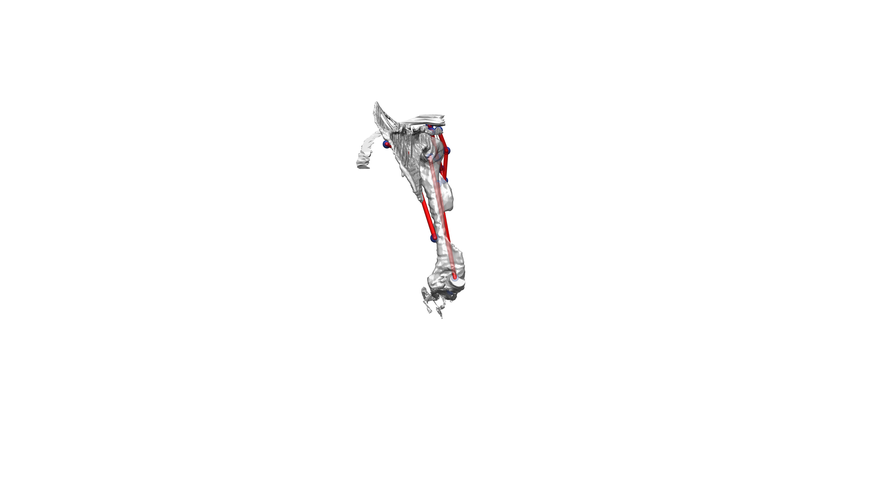

""

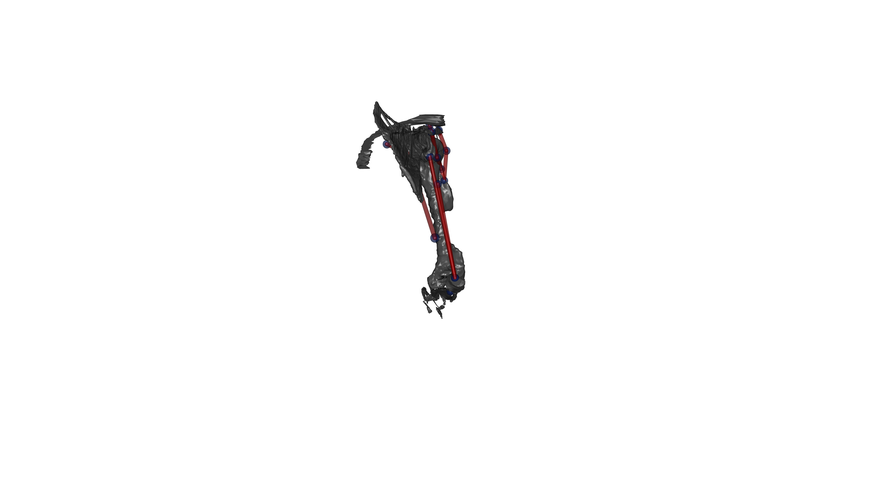

""

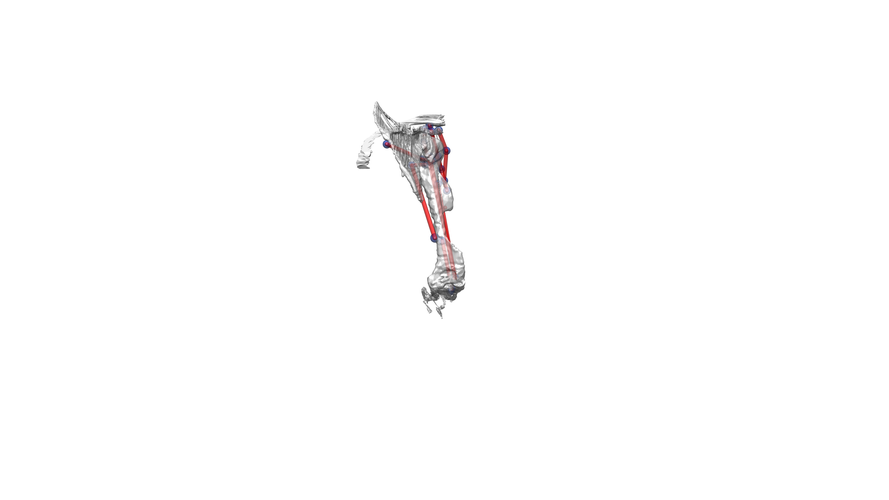

In [52]:
render(env_all.mj_model)
render(env_imitator.mj_model)
render(env_reference.mj_model)

In [32]:
from track_mjx.analysis.utils import load_from_h5py
from jax import numpy as jp

rollouts = load_from_h5py(
    "/home/talmolab/vast/eric/track-mjx/notebooks/rollouts_full_data_11_7_25.h5"
)
qposes_rollout, qposes_ref = jp.array(rollouts["qpos"]), jp.array(rollouts["ref_qpos"])
qposes_rollout.shape, qposes_ref.shape

((46, 100, 4), (46, 100, 4))

In [43]:
qposes_rollout, qposes_ref = (
    rollouts["qpos"][:, ::2, :],
    rollouts["ref_qpos"][:, ::2, :],
)

In [44]:
qposes_ref.shape

(46, 50, 4)

In [ ]:
num_arms = 5
# configure the desired clip to visualize
clip_id, start_idx, stride = 0, 0, 5

# index out the desired clip and stride
qposes_rollout_selected = qposes_rollout[
    clip_id, start_idx : start_idx + stride * num_arms : stride, :
]
qposes_ref_selected = qposes_ref[
    clip_id, start_idx : start_idx + stride * num_arms : stride, :
]

# Flatten for final use
qposes_rollout_selected = qposes_rollout_selected.flatten()
qposes_ref_selected = qposes_ref_selected.flatten()

In [6]:
num_arms

1

In [7]:
qposes_all = jp.concatenate([qposes_rollout_selected, qposes_ref_selected], axis=0)
qposes_all.shape

NameError: name 'qposes_rollout_selected' is not defined

In [ ]:
clip_id, start_idx, stride = 1, 0, 10
for i in range(5):
    # index out the desired clip and stride
    qposes_rollout_selected = qposes_rollout[
        clip_id, start_idx : start_idx + stride : stride, :
    ]
    qposes_ref_selected = qposes_ref[
        clip_id, start_idx : start_idx + stride : stride, :
    ]
    start_idx += stride
    # Flatten for final use
    qposes_rollout_selected = qposes_rollout_selected.flatten()
    qposes_ref_selected = qposes_ref_selected.flatten()
    data_all = mj.MjData(env_all.mj_model)
    data_all.qpos = jp.concatenate(
        [qposes_rollout_selected, qposes_ref_selected], axis=0
    )
    camera_name = "close-profile"
    render(
        env_all.mj_model,
        data_all,
        camera=f"{camera_name}-ghost-0",
        save=True,
        filename=f"./figures/fig4/fig4d_mouse_arm_traj_replay_overlay_sequence_{clip_id=}_{start_idx=}_{stride=}_frame_{i}.png",
    )

# Arm video

In [53]:
import mediapy as media
from tqdm import tqdm

In [54]:
np.vstack(qposes_ref).shape

(2300, 4)

In [55]:
mj_model = env_reference.mj_model
mj_data = mj.MjData(mj_model)
# Warm up kinematics and reset renderer
mujoco.mj_kinematics(mj_model, mj_data)
renderer = mujoco.Renderer(mj_model, height=512, width=1024)
frames = []
for qpos in tqdm(np.vstack(qposes_ref)):
    mj_data.qpos = qpos
    mujoco.mj_forward(mj_model, mj_data)
    renderer.update_scene(mj_data, camera="close-profile-ghost-0")
    frames.append(renderer.render())

100%|██████████| 2300/2300 [00:02<00:00, 771.88it/s]


In [ ]:
fps = 50
media.show_video(frames, fps=fps)
media.write_video("ref_trans_all.mp4", frames, fps=fps)

: 

In [14]:
qposes_ref.shape

(46, 50, 4)

In [45]:
qposes_all = np.concatenate((qposes_rollout, qposes_ref), axis=-1)
qposes_all = np.vstack(qposes_all)
qposes_all.shape

(2300, 8)

In [46]:
mj_model = env_all.mj_model
mj_data = mj.MjData(mj_model)
# Warm up kinematics and reset renderer
mujoco.mj_kinematics(mj_model, mj_data)
renderer = mujoco.Renderer(mj_model, height=512, width=1024)
frames = []
for qpos in tqdm(qposes_all):
    mj_data.qpos = qpos
    mujoco.mj_forward(mj_model, mj_data)
    renderer.update_scene(mj_data, camera="close-profile-mouse-0")
    frames.append(renderer.render())

100%|██████████| 2300/2300 [00:12<00:00, 184.98it/s]


In [47]:
fps = 50
media.show_video(frames, fps=fps)
media.write_video("rollout_full.mp4", frames, fps=fps)